Now I'm going to attempt to solve for the combined island ridge system with no damping. Learning from the numerical infinite ridge runs I will make the ridge 1/5th of the azimuthal domain. Parameter values will be guided by the analytical problem. I just want to get one good system, showwaves going along the ridge at lower frequencies.

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import dedalus.public as d3
import logging
logger = logging.getLogger(__name__)

In [2]:
import warnings
warnings.filterwarnings("ignore")

In [3]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
import matplotlib as mpl
mpl.rc('text', usetex = True)
mpl.rc('font', family = 'serif')
mpl.rc('xtick', labelsize=18) 
mpl.rc('ytick', labelsize=18) 
mpl.rcParams.update({'font.size': 18})


In [4]:
from dedalus.core.operators import SpectralOperator1D

class ComplexFourierPseudodifferential(SpectralOperator1D):

    input_basis_type = d3.ComplexFourier
    subaxis_dependence = [True]
    subaxis_coupling = [False]

    def __init__(self, operand, coord, out=None):
        super().__init__(operand, out=out)
        # SpectralOperator requirements
        self.coord = coord
        self.input_basis = operand.domain.get_basis(coord)
        self.output_basis = self.input_basis
        self.first_axis = coord.axis
        self.last_axis = coord.axis
        self.axis = coord.axis
        # LinearOperator requirements
        self.operand = operand
        # FutureField requirements
        self.domain = operand.domain.substitute_basis(self.input_basis, self.output_basis)
        self.tensorsig = operand.tensorsig
        self.dtype = operand.dtype

    @classmethod
    def _group_matrix(cls, group, input_basis, output_basis):
        # Rescale group (native wavenumber) to get physical wavenumber
        k = group / input_basis.COV.stretch
        # dx exp(1j*k*x) = 1j * k * exp(1j*k*x)
        return np.array([[cls.k_func(k)]])


class abs_m_cls(ComplexFourierPseudodifferential):

    name = "abs_m"

    @classmethod
    def k_func(cls, k):
        return abs(k)

    def new_operand(self, operand, **kw):
        if operand == 0:
            return 0
        return abs_m_cls(operand,  self.coord, **kw)

## $\beta=0.5$ Bathymetry, 64x64 Resolution 

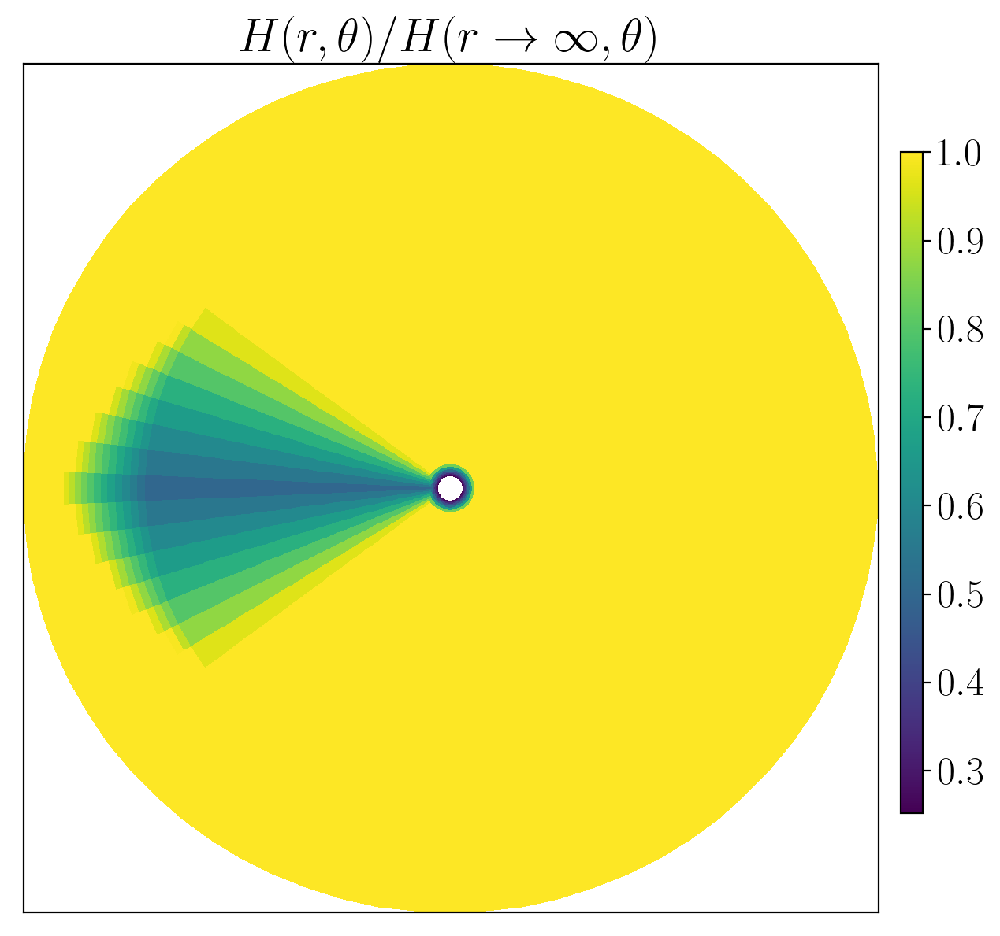

In [5]:
## variable parameters ##
Ro = 17;
Rs = 12;
Nθ = 74;
Nr = 74;
##########################


## fixed parameters 
β = 0.5;
Ri= 0.5;
α = 1 
W = np.pi/5; 
b = -np.log(1/β*0.25)/(2*W);
C = np.pi;
steep = 0.2;

#Basis
coords = d3.CartesianCoordinates('θ', 'r')
dist = d3.Distributor(coords, dtype=np.complex128)
θ_basis = d3.Fourier(coords['θ'], Nθ, (0, 2*np.pi), dtype=np.complex128)
r_basis = d3.Chebyshev(coords['r'], Nr, (Ri, Ro))
# Fields
Φ = dist.Field(name='Φ', bases=(θ_basis, r_basis))
tau1 = dist.Field(name='tau1', bases=θ_basis)
tau2 = dist.Field(name='tau2', bases=θ_basis)
ωinv = dist.Field(name='ωinv')

# Substitutions
dθ = lambda A: d3.Differentiate(A, coords['θ'])
dr = lambda A: d3.Differentiate(A, coords['r'])
θ, r = dist.local_grids(θ_basis, r_basis)

rinv = dist.Field(bases=r_basis); rinv['g'] = r**(-1)

lift_basis = r_basis.derivative_basis(2)
tau_terms = d3.Lift(tau1, lift_basis, -1) + d3.Lift(tau2, lift_basis, -2)
m_func = lambda m: abs(m)
abs_m = lambda A: abs_m_cls(A, coords['θ']) #note this implements the Dirichlet-to-Neumann BC

## bathymetry ##
R,THETA = np.meshgrid(r,θ)
Hisland = R**(2*α) 
Hisland[Hisland>1] = 1
Hridge = np.exp(2*b*(np.abs(C-THETA)-W))
Hridge[Hridge>1] = 1
Hridge[R>Rs] = Hridge[R>Rs]*np.exp(steep*(R[R>Rs]-Rs))
# Hridge[R>Rs] = 1
Hridge[Hridge>1] = 1
H = np.where(Hisland<Hridge,Hisland,Hridge)

## bathymetry as field ##
Hinv = dist.Field(bases=(θ_basis,r_basis))
Hinv['g'] = H**(-1)

## plot bathymetry
R,THETA = np.meshgrid(r,θ)
x = R*np.cos(THETA); y=R*np.sin(THETA)
fig,(ax) = plt.subplots(1,1, figsize=(7,7))
c=ax.pcolormesh(x,y,1/Hinv['g'].real)
ax.set_title(r'$H(r,\theta)/H(r\to\infty, \theta)$')
cax = fig.add_axes([0.92, 0.2, 0.02, 0.6])
cbar=plt.colorbar(c,cax = cax,orientation='vertical',shrink = 0.5)
ax.set_xticks([]);ax.set_yticks([])
plt.show()

# Problem
problem = d3.EVP([Φ, tau1, tau2], eigenvalue=ωinv, namespace=locals())
problem.add_equation("Hinv*(dr(dr(Φ)) + rinv*dr(Φ) + rinv**2*dθ(dθ(Φ))) + dr(Φ)*dr(Hinv) + rinv**2*dθ(Φ)*dθ(Hinv) + 1j*rinv*ωinv*(dr(Φ)*dθ(Hinv) - dθ(Φ)*dr(Hinv)) + tau_terms = 0 ")
problem.add_equation("Φ(r=Ri)=0") #inner BC
problem.add_equation("dr(Φ)(r=Ro) + abs_m(Φ)(r=Ro) / Ro = 0") #outer BC


In [ ]:
%%time
## solver (edit names with each run) ##
solver = problem.build_solver(matrix_coupling=(True,True))
solver.solve_sparse(solver.subproblems[0], 40,-1/0.3) 

In [ ]:
r = r[0]; θ = θ.T[0]

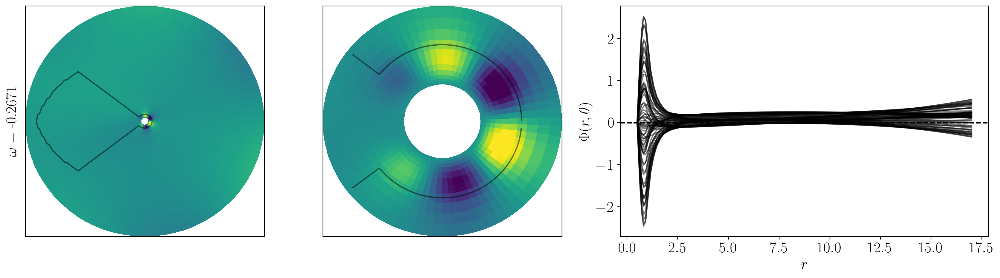

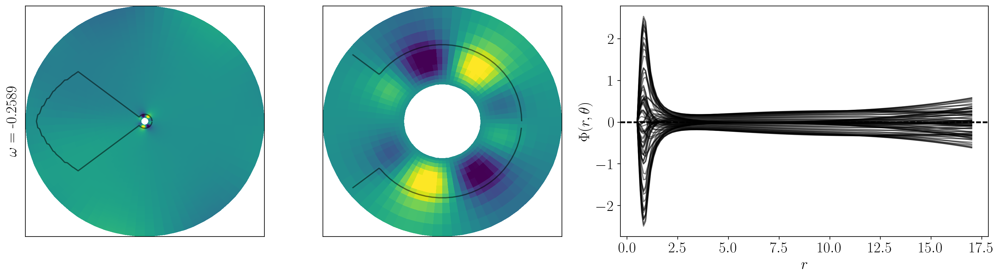

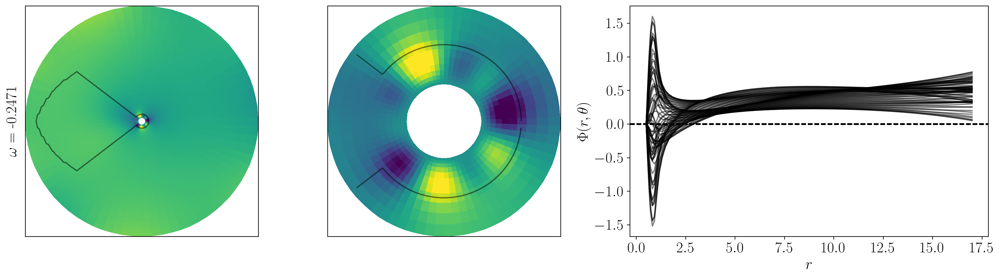

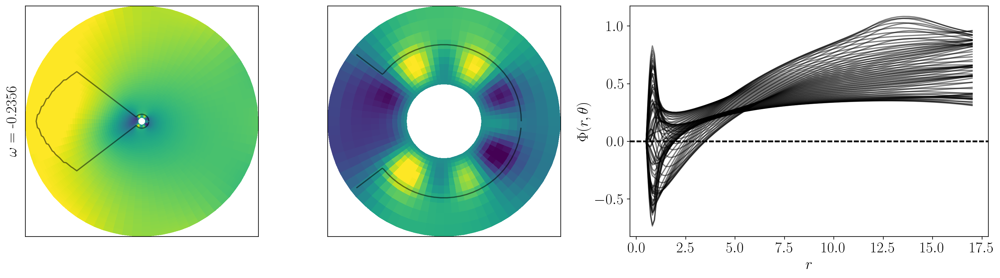

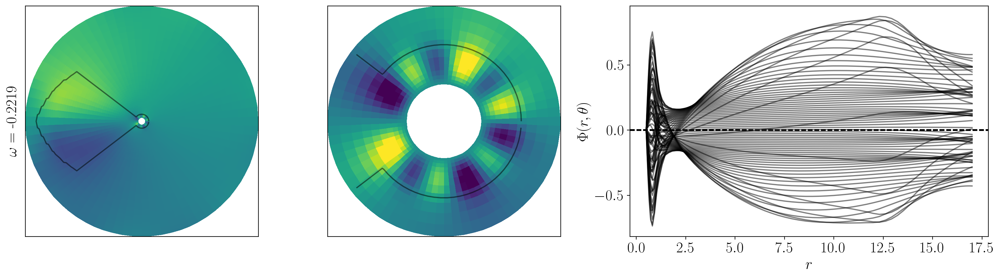

...

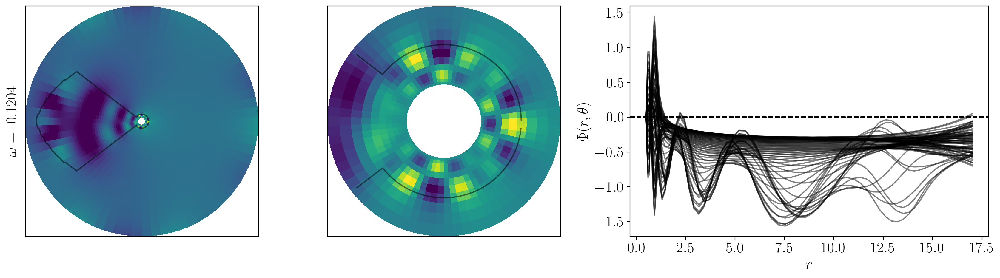

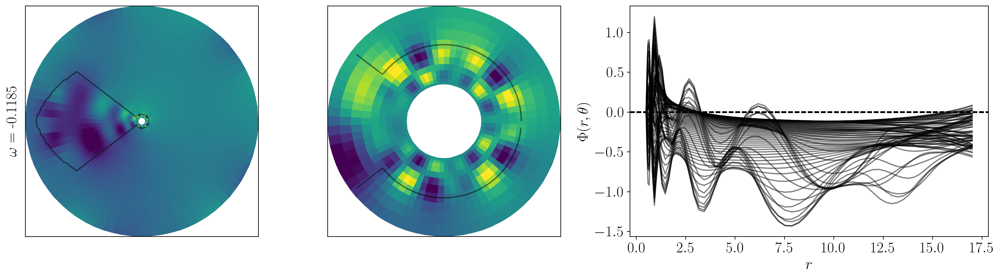

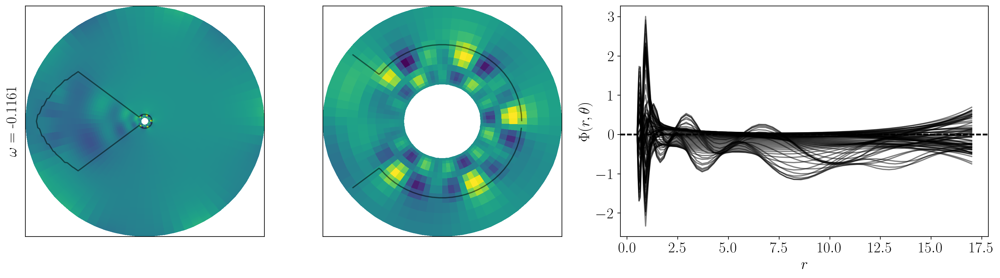

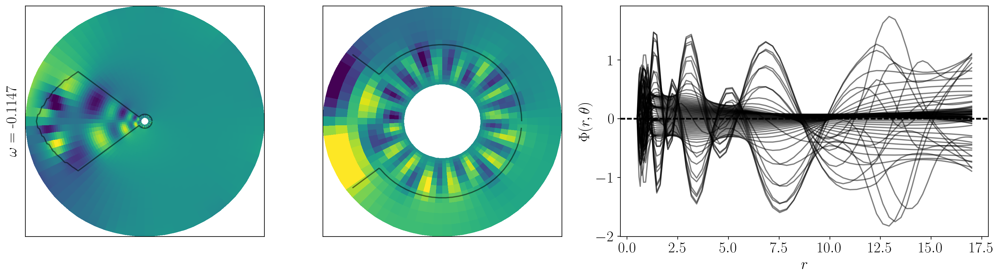

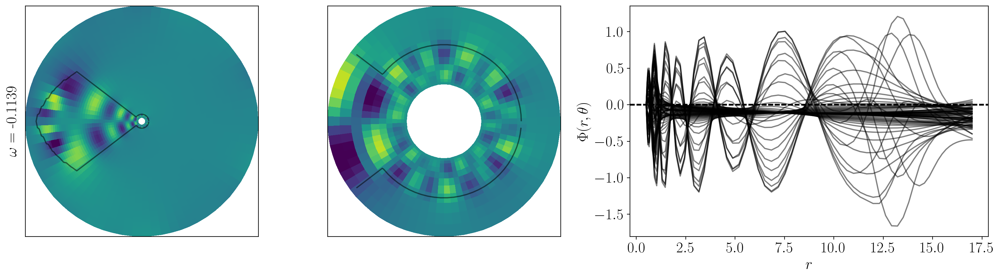

In [8]:
for i in range(30):
    fig,(ax,ax2,ax1) = plt.subplots(1,3, figsize=(17,5),gridspec_kw={'width_ratios': [1.3,1.3,2]})    
    X = R*np.cos(THETA); Y=R*np.sin(THETA)
    solver.set_state(i, solver.subproblems[0].subsystems[0]) 
    Φg = Φ['g']
    vmax=np.max(np.abs(Φg))*0.75;vmin=-vmax
    ax.pcolormesh(X,Y,Φg.real, vmin=vmin,vmax=vmax)
    ax.contour(X,Y,H, levels=[0.99,1], colors='k', alpha=0.5)
    vmax=np.max(np.abs(Φg[:,:int(Nr/8)]))*0.75;vmax=max(vmax,0.2);vmin=-vmax
    ax2.pcolormesh(X[:,:int(Nr/6)],Y[:,:int(Nr/6)],Φg.real[:,:int(Nr/6)], vmin=vmin,vmax=vmax)
    ax2.contour(X[:,:int(Nr/6)],Y[:,:int(Nr/6)],H[:,:int(Nr/6)], levels=[0.99,1], colors='k', alpha=0.5)
    for j in range(Nθ):
        ax1.plot(r, Φg.real[j,:], 'k', alpha=0.5)
        ax1.axhline(0,color='k',linestyle='dashed')
    ax.set_ylabel(r'$\omega = $ %5.4f'%(1/solver.eigenvalues.real[i]))
    ax1.set_xlabel('$r$'); ax1.set_ylabel(r'$\Phi(r,\theta)$');
    ax.set_xticks([]);ax.set_yticks([]);ax2.set_xticks([]);ax2.set_yticks([])
    fig.tight_layout()
    plt.show()

## High pass filtering (want to remove the low modes associated with the full island).

Note this requires interpolation onto an even $r$ grid.

In [ ]:
from scipy.signal import sosfiltfilt, butter

In [ ]:
## Load package
from scipy.signal import sosfiltfilt, butter

## Define function
def butter_highpass(highcut, fs, order):
    nyq = 0.5 * fs
    high = highcut / nyq
    sos = butter(order,  high, analog=False, btype='high', output='sos')
    return sos

def butter_highpass_filter(data, highcut, fs, order=None, padtype=None, padlen=None):
    if order == None:
        order = 5
    if padtype == None:
        padtype = 'odd'
    if padlen == None:
        padlen = int(len(data)/2)    
    sos = butter_highpass(highcut, fs, order=order)
    y = sosfiltfilt(sos, data, padtype='odd', padlen=padlen)
    return y    

In [ ]:
for i in range(20):
    fig,(ax,ax2,ax1) = plt.subplots(1,3, figsize=(17,5),gridspec_kw={'width_ratios': [1.3,1.3,2]})
    r_reg = np.arange(0.5,Ro,0.1)
    solver.set_state(i, solver.subproblems[0].subsystems[0]) 
    ## interpolation and filtering
    Φg = Φ['g']
    f = interpolate.interp2d(r, θ, Φg, kind='cubic')
    Φg_reg = f(r_reg, θ)
    fs = 1/(np.diff(r_reg))[0]
    highfreq = 1/12 # filter out waves longer than the ridge
    Φg_hp  = butter_highpass_filter(Φg_reg,highfreq,fs,order=5)
    R_reg,THETA_reg = np.meshgrid(r_reg,θ)
    X_reg = R_reg*np.cos(THETA_reg); Y_reg=R_reg*np.sin(THETA_reg)

    vmax=np.max(np.abs(Φg_hp))*0.75;vmin=-vmax
    ax.pcolormesh(X_reg,Y_reg,Φg_hp.real, vmin=vmin,vmax=vmax)
    ax.contour(X,Y,H, levels=[0.99,1], colors='k', alpha=0.5)
    vmax=np.max(np.abs(Φg_hp[:,:int(Nr/8)]))*0.75; vmax=max(vmax,0.2);vmin=-vmax
    ax2.pcolormesh(X_reg[:,:int(Nr/6)],Y_reg[:,:int(Nr/6)],Φg_hp.real[:,:int(Nr/6)], vmin=vmin,vmax=vmax)
    ax2.contour(X[:,:int(Nr/6)],Y[:,:int(Nr/6)],H[:,:int(Nr/6)], levels=[0.99,1], colors='k', alpha=0.5)

    ax1.plot(r_reg, Φg_hp.T, 'k', alpha=0.2);
    ax1.axhline(0, color='k', linestyle='dashed')

    ax.set_ylabel(r'$\omega = $ %5.4f'%(1/solver.eigenvalues.real[i]))
    ax1.set_xlabel('$r$'); ax1.set_ylabel(r'$\Phi(r,\theta)$');
    ax.set_xticks([]);ax.set_yticks([]);ax2.set_xticks([]);ax2.set_yticks([])
    fig.tight_layout()
    plt.show()

So the high pass filtering above leaves a few artifacts, means it's not smooth in the $\theta$ direction. I think I prefer just removing the mean $\Phi(r)$, seems to do the job.

## Mean removal filtering

In [9]:
1/solver.eigenvalues.real

array([-0.26714843, -0.25887371, -0.24712543, -0.23562653, -0.22186471,
       -0.21620635, -0.20594731, -0.19442509, -0.19129471, -0.18448054,
       -0.17771006, -0.16835323, -0.16581748, -0.15861386, -0.15437874,
       -0.15103921, -0.14385805, -0.14047559, -0.13548601, -0.12862157,
       -0.12862157, -0.12298801, -0.12206495, -0.12129833, -0.12129833,
       -0.12038672, -0.11846591, -0.11607095, -0.1147457 , -0.11385273,
       -0.11232148, -0.11008067, -0.10914973, -0.10708842, -0.10575121,
       -0.10420534, -0.10347418, -0.10097759, -0.09974682, -0.09885326])

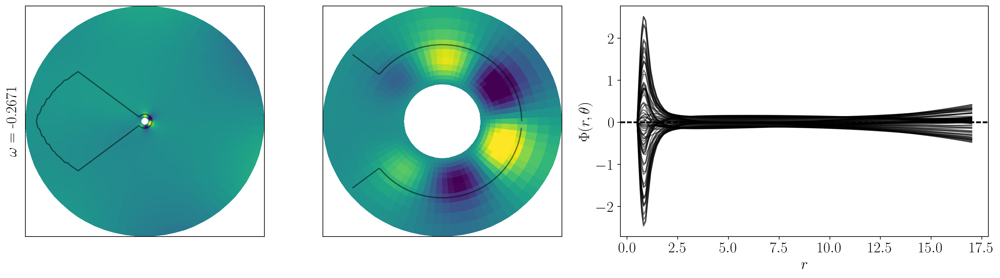

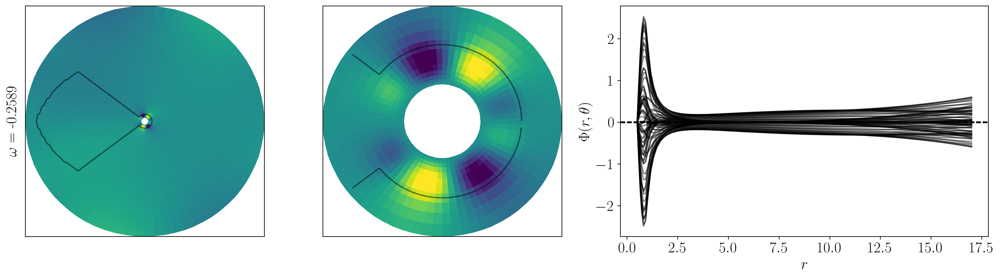

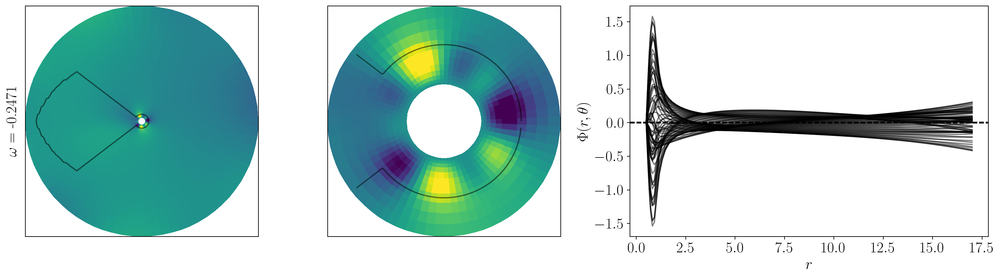

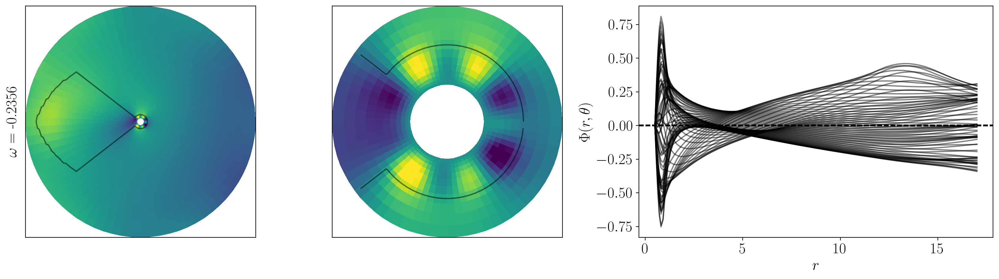

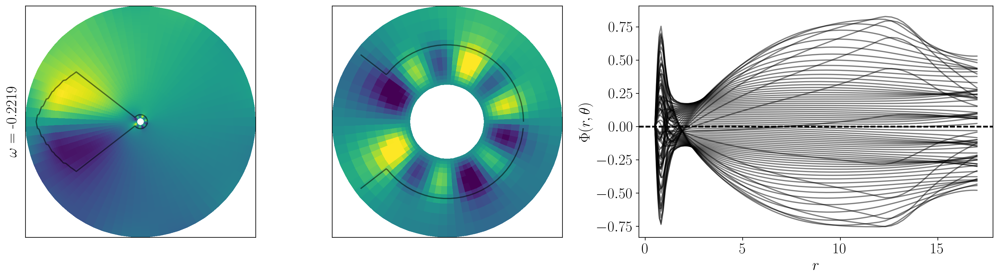

...

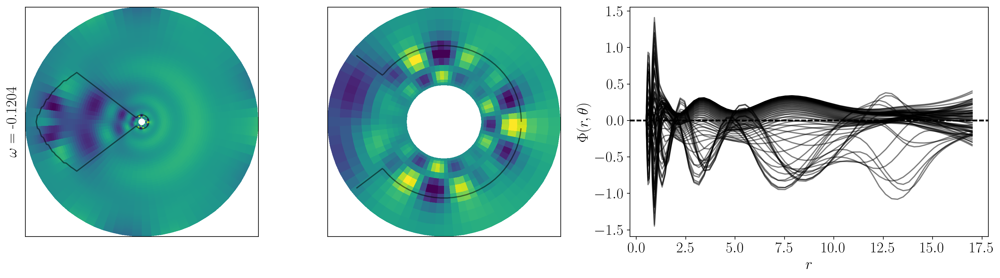

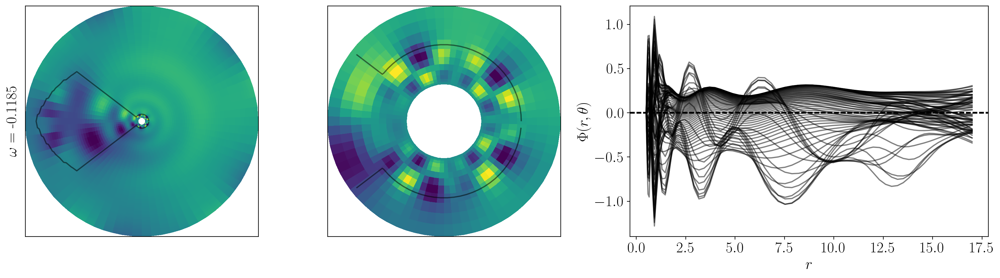

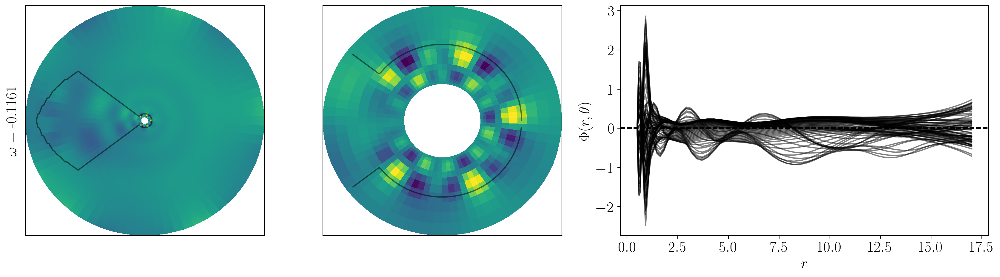

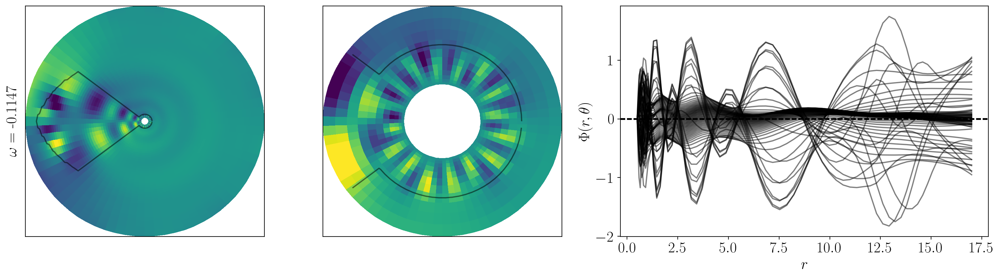

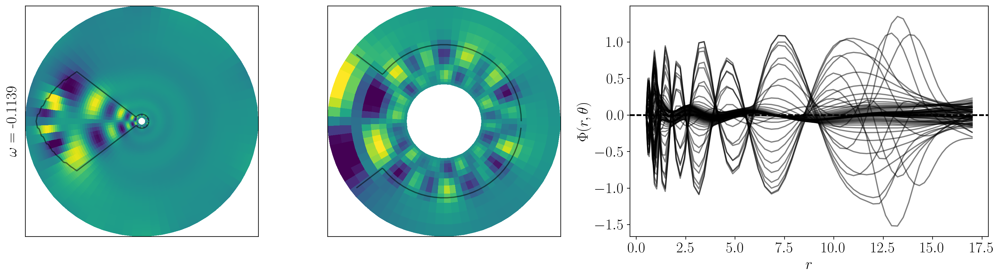

In [10]:
for i in range(30):
    fig,(ax,ax2,ax1) = plt.subplots(1,3, figsize=(17,5),gridspec_kw={'width_ratios': [1.3,1.3,2]})    
    X = R*np.cos(THETA); Y=R*np.sin(THETA)
    solver.set_state(i, solver.subproblems[0].subsystems[0]) 
    Φg = Φ['g']
    Φg = (Φg-np.mean(Φg, axis=0))
    vmax=np.max(np.abs(Φg))*0.75;vmin=-vmax
    ax.pcolormesh(X,Y,Φg.real, vmin=vmin,vmax=vmax)
    ax.contour(X,Y,H, levels=[0.99,1], colors='k', alpha=0.5)
    vmax=np.max(np.abs(Φg[:,:int(Nr/8)]))*0.75;vmax=max(vmax,0.2);vmin=-vmax
    ax2.pcolormesh(X[:,:int(Nr/6)],Y[:,:int(Nr/6)],Φg.real[:,:int(Nr/6)], vmin=vmin,vmax=vmax)
    ax2.contour(X[:,:int(Nr/6)],Y[:,:int(Nr/6)],H[:,:int(Nr/6)], levels=[0.99,1], colors='k', alpha=0.5)
    for j in range(Nθ):
        ax1.plot(r, Φg.real[j,:], 'k', alpha=0.5)
        ax1.axhline(0,color='k',linestyle='dashed')
    ax.set_ylabel(r'$\omega = $ %5.4f'%(1/solver.eigenvalues.real[i]))
    ax1.set_xlabel('$r$'); ax1.set_ylabel(r'$\Phi(r,\theta)$');
    ax.set_xticks([]);ax.set_yticks([]);ax2.set_xticks([]);ax2.set_yticks([])
    fig.tight_layout()
    plt.show()

## Kinetic Energy

Now, we could (and I did for the presentation at WHOI GFD) simply identify by eye when these eigenmodes have strong expression on the ridge or not. Eventually I will want a more quantitative sorting mechanism. A good candidate is comparing the kinetic energy of the field in different regions (e.g. radial regions or even more specific regions cutting out the ridge - will start with radial breakdown though).

The kinetic energy of this field is

$$KE = \nabla\Phi\cdot\nabla\Phi^*$$

where $*$ indicates the complex conjugate and $\nabla$ in polar coordinates is

$$\nabla = \frac{\partial}{\partial r}\hat{\boldsymbol{r}}+\frac{1}{r}\frac{\partial}{\partial \theta}\hat{\boldsymbol{\theta}}.$$

In [131]:
def kinetic_energy(Φg):
    dΦ_dr = np.gradient(Φg,r,axis=1)
    dΦ_dθ = 1/r*np.gradient(Φg,np.gradient(θ)[0],axis=0)
    gradΦ = dΦ_dr + dΦ_dθ
    ke = gradΦ*np.conj(gradΦ) 
    return ke.real

In [113]:
solver.set_state(0, solver.subproblems[0].subsystems[0]) 
Φg = Φ['g']
ke = kinetic_energy(Φg)

In [141]:
max_ridge = np.zeros(30)

In [143]:
max_island = np.zeros(30)

In [145]:
max_ridge

array([0.04141274, 0.48161019, 0.03169518, 0.04268713, 0.01076463,
       0.04714231, 0.21234417, 0.04567279, 0.68441762, 0.30965082,
       0.34300646, 0.55946231, 0.54676167, 0.02446597, 0.10009143,
       0.03429776, 0.34409192, 0.20880687, 0.72149206, 1.32019389,
       0.49675378, 3.86847552, 0.40189523, 0.30404092, 0.87164618,
       1.39694159, 3.31896497, 0.7396403 , 0.86469692, 3.06829847])

In [146]:
max_island

array([2.46887478e+02, 4.41878981e-02, 1.47296108e+02, 2.60110530e+02,
       4.96914140e+01, 1.86525062e+01, 9.10586156e-01, 1.08684106e+02,
       1.66336697e+00, 3.76974367e+00, 3.62642799e+00, 2.53809473e+01,
       1.60248980e+01, 7.34544932e+00, 3.28850376e+00, 3.00120599e+00,
       6.70060054e+00, 6.63450538e+00, 4.76090797e+01, 2.44773559e+01,
       1.56588988e+01, 5.10741258e+01, 1.33284868e+02, 8.38940705e+02,
       1.35421815e+02, 4.31637280e+02, 7.91066667e+01, 2.49093482e+02,
       1.79708271e+02, 2.31951914e+02])

In [147]:
max_ridge/max_island

array([1.67739348e-04, 1.08991424e+01, 2.15180030e-04, 1.64111496e-04,
       2.16629654e-04, 2.52739803e-03, 2.33195039e-01, 4.20234289e-04,
       4.11465196e-01, 8.21410813e-02, 9.45852118e-02, 2.20426097e-02,
       3.41195100e-02, 3.33076515e-03, 3.04367686e-02, 1.14279922e-02,
       5.13524000e-02, 3.14728616e-02, 1.51545054e-02, 5.39353143e-02,
       3.17234173e-02, 7.57423736e-02, 3.01531025e-03, 3.62410503e-04,
       6.43652709e-03, 3.23637845e-03, 4.19555659e-02, 2.96932820e-03,
       4.81167013e-03, 1.32281662e-02])

(0.0, 1.0)

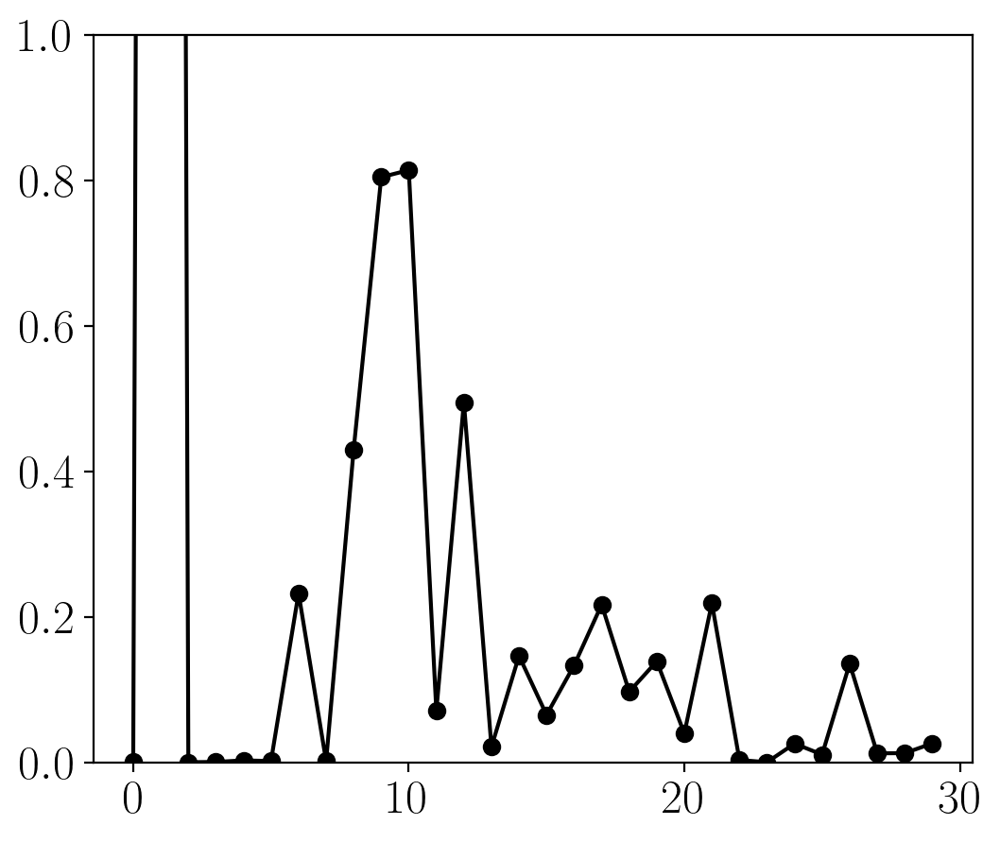

In [170]:
fig,(ax) = plt.subplots(1,1, figsize=(6,5))    
ax.plot(max_ridge/max_island, 'ko-')
ax.set_ylim([0,1])
# ax.set_yscale('log')

In [ ]:
for i in range(30):
    fig,(ax,ax2,ax1) = plt.subplots(1,3, figsize=(17,5),gridspec_kw={'width_ratios': [1.3,1.3,2]})    
    X = R*np.cos(THETA); Y=R*np.sin(THETA)
    solver.set_state(i, solver.subproblems[0].subsystems[0]) 
    Φg = Φ['g']
    ke = kinetic_energy(Φg)
    max_ridge[i]=np.max(ke[:,14:42])
    max_island[i]=np.max(ke[:,:14])
    
    vmax=np.max(np.abs(ke))*0.75;vmin=-vmax
    ax.pcolormesh(X,Y,ke, vmin=vmin,vmax=vmax)
    ax.contour(X,Y,H, levels=[0.99,1], colors='k', alpha=0.5)
    vmax=np.max(np.abs(ke[:,:int(Nr/8)]))*0.75;vmax=max(vmax,0.2);vmin=-vmax
    ax2.pcolormesh(X[:,:int(Nr/6)],Y[:,:int(Nr/6)],ke[:,:int(Nr/6)], vmin=vmin,vmax=vmax)
    ax2.contour(X[:,:int(Nr/6)],Y[:,:int(Nr/6)],H[:,:int(Nr/6)], levels=[0.99,1], colors='k', alpha=0.5)
    for j in range(Nθ):
        ax1.plot(r, np.max(ke,axis=0), 'k', alpha=0.5)
        ax1.axhline(0,color='k',linestyle='dashed')
        ax1.axvline(1,color='r',linestyle='dashed')
    ax.set_ylabel(r'$\omega = $ %5.4f'%(1/solver.eigenvalues.real[i]))
    ax1.set_xlabel('$r$'); ax1.set_ylabel(r'$\nabla\Phi \cdot \nabla \Phi^*$');
#     ax1.set_ylim(0,4)
    
    ax.set_xticks([]);ax.set_yticks([]);ax2.set_xticks([]);ax2.set_yticks([])
    fig.tight_layout()
    plt.show()